**Install All the Ultralytics Package**

In [1]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"


In [2]:
!pip install ultralytics
!pip install opencv-python

**Import All the Required Libraries**

In [3]:
from ultralytics import YOLO
from IPython.display import Image

**Download the Dataset from Roboflow**

In [4]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="OUx13M4wAVBt0qeZboyR")
project = rf.workspace("project-uyrxf").project("potholes-detection-segmentation")
version = project.version(1)
dataset = version.download("yolov11")

loading Roboflow workspace...
loading Roboflow project...


In [5]:
dataset.location

'/content/Potholes-Detection-Segmentation-1'

**Train the YOLO11 Segmentation Model on a Custom Dataset**

In [6]:
#Load the YOLO11-Seg Model
model = YOLO("yolo11s-seg.pt")

**Please make sure to update the train and validation dataset images path before starting training**

In **data.yaml** change :

train: /content/Potholes-Detection-Segmentation-1/train/images

val: /content/Potholes-Detection-Segmentation-1/valid/images

test: /content/Potholes-Detection-Segmentation-1/test/images

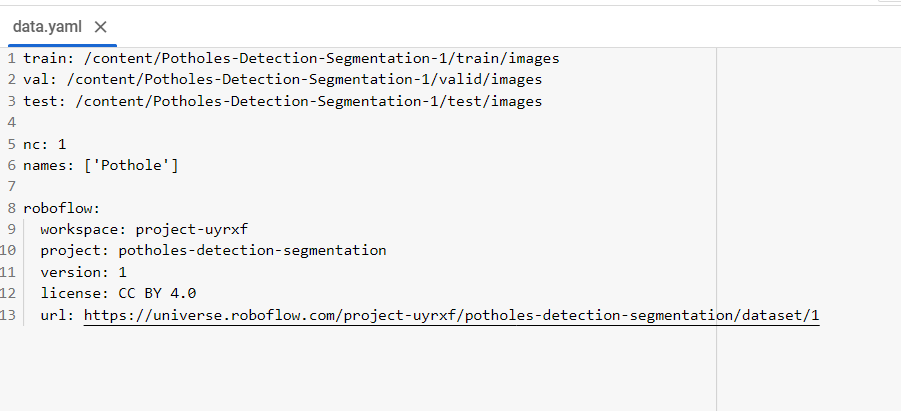

In [8]:
#Train the Model on a Custom Dataset
results = model.train(task='segment', mode = 'train', data = "/content/Potholes-Detection-Segmentation-1/data.yaml", epochs = 90)

Ultralytics 8.3.195 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Potholes-Detection-Segmentation-1/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=90, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11s-seg.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train2, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0, plot

**Download the Best Model Weights**

In [9]:
!gdown "https://drive.google.com/uc?id=1DnQ3jNXUn4SxMjW5KtHGfzjNHY79VjR3&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1DnQ3jNXUn4SxMjW5KtHGfzjNHY79VjR3&confirm=t
To: /content/best.pt
100% 20.5M/20.5M [00:00<00:00, 52.7MB/s]


**Examining Results**

**Box and Mask Curves of Precision-Confidence and Recall - Confidence**

In [10]:
result_path = "/content/runs/segment/train2"

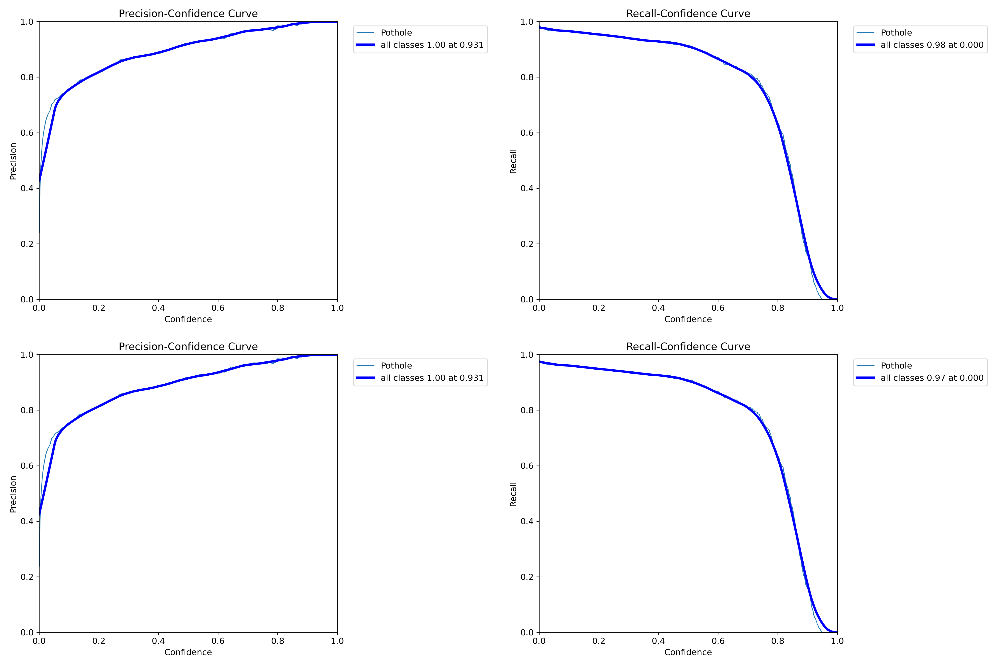

In [11]:
import cv2
from google.colab.patches import cv2_imshow
#Load your images using OpenCV
img1 = cv2.imread(f"{result_path}/BoxP_curve.png")
img2 = cv2.imread(f"{result_path}/BoxR_curve.png")
img3 = cv2.imread(f"{result_path}/MaskP_curve.png")
img4 = cv2.imread(f"{result_path}/MaskR_curve.png")

#Concatenate the images horizontally
top_row = cv2.hconcat([img1, img2])
botton_row = cv2.hconcat([img3, img4])

#Concatenate the two rows vertically
grid = cv2.vconcat([top_row, botton_row])
#Display the concatenated images
cv2_imshow(grid)


**Confusion Matrix**

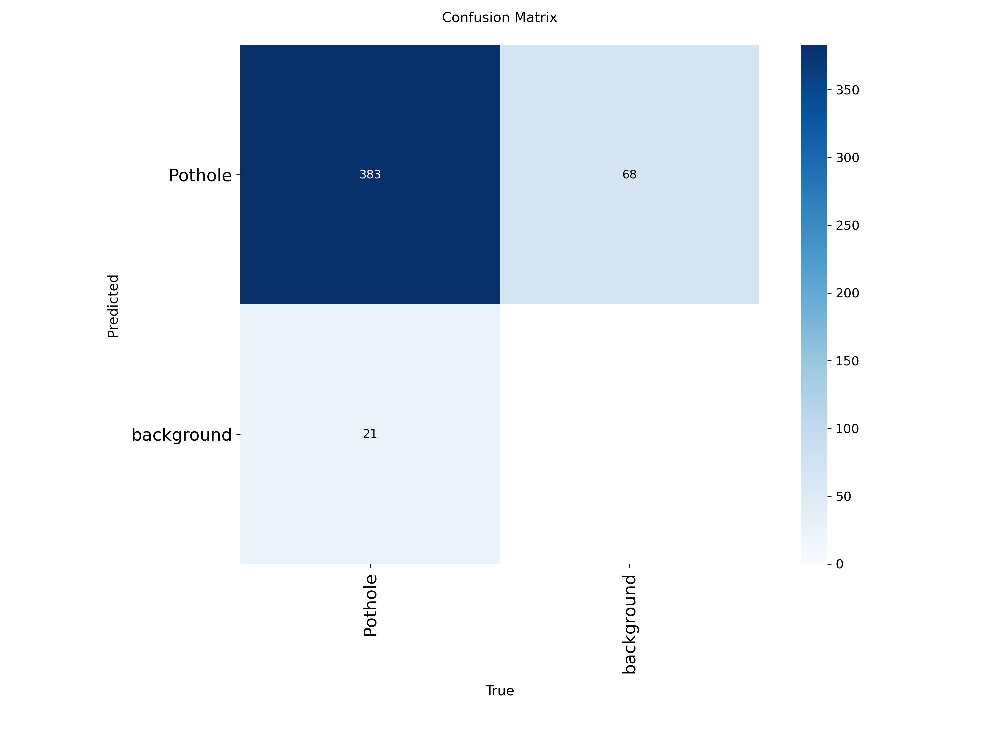

In [12]:
Image("/content/runs/segment/train2/confusion_matrix.png", width = 800)

**Normalized Confusion Matrix**

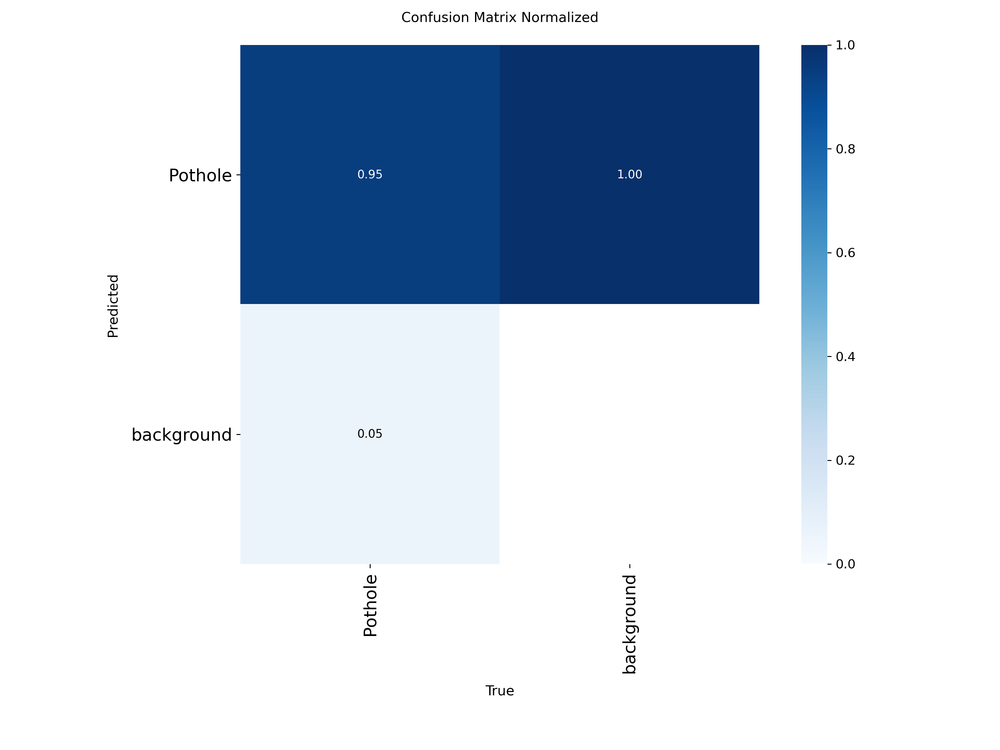

In [13]:
Image("/content/runs/segment/train2/confusion_matrix_normalized.png", width = 800)

**Model Prediction on Validation Batch**

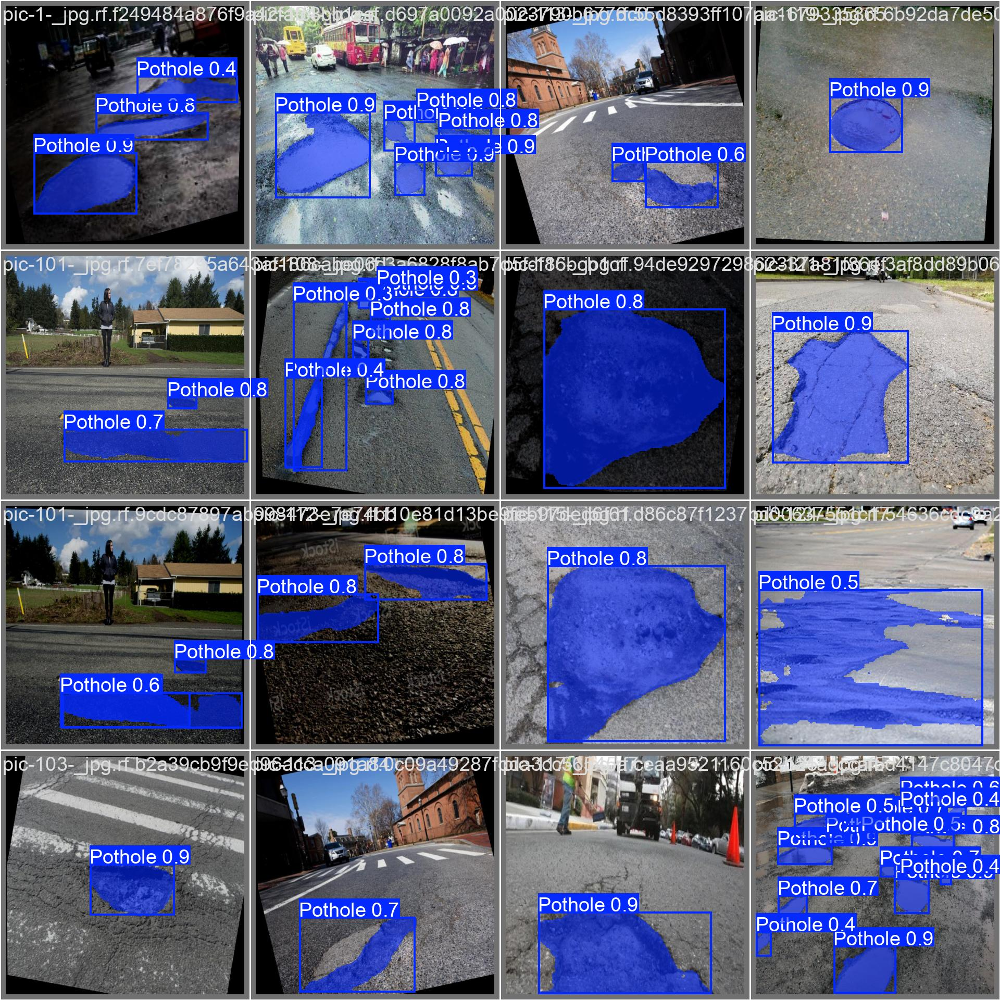

In [14]:
Image("/content/runs/segment/train2/val_batch0_pred.jpg", width = 800)

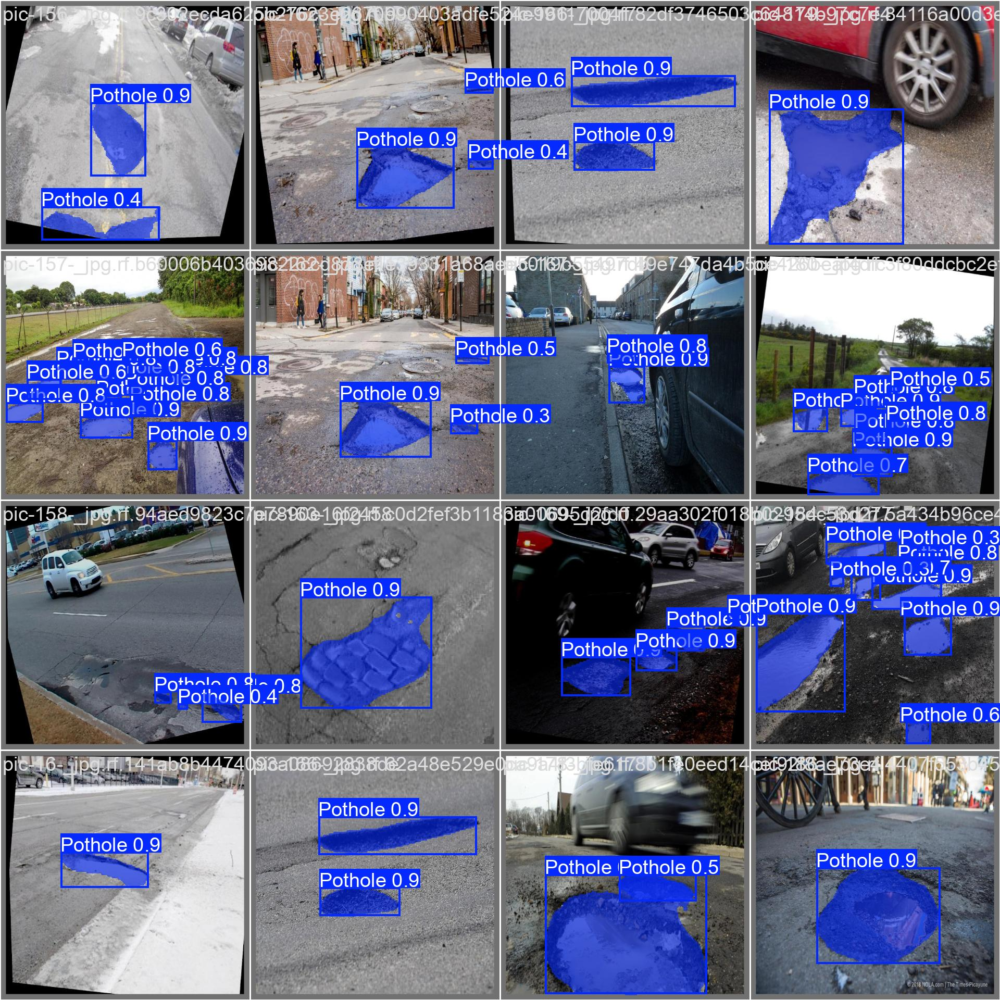

In [15]:
Image("/content/runs/segment/train2/val_batch1_pred.jpg", width = 800)

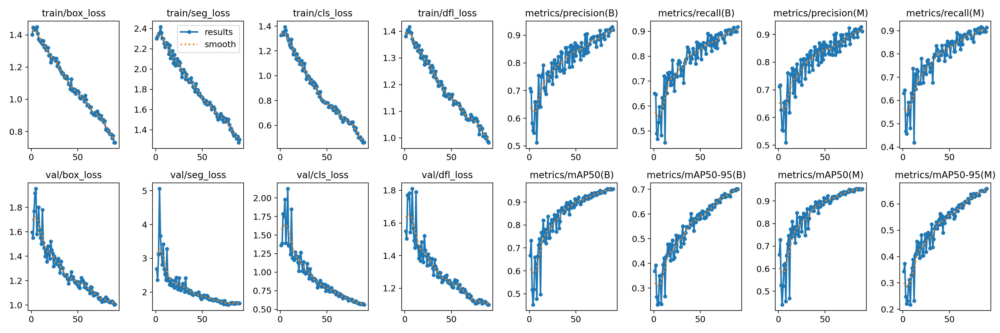

In [16]:
Image("/content/runs/segment/train2/results.png", width = 800)

**Validate Fine-Tuned Model**

In [17]:
metrics = model.val()
# Print the evaluation metrics
print("Model Evaluation Metrics:", metrics)


Ultralytics 8.3.195 🚀 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11s-seg summary (fused): 113 layers, 10,067,203 parameters, 0 gradients, 32.8 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 2112.6±647.9 MB/s, size: 86.9 KB)
val: Scanning /content/Potholes-Detection-Segmentation-1/valid/labels.cache... 156 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 156/156 309.1Kit/s 0.0s
WARNING ⚠️ Limiting validation plots to first 50 items per image for speed...
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 10/10 1.7it/s 5.8s
                   all        156        404      0.918      0.918      0.957      0.702      0.909      0.913      0.953      0.654
Speed: 4.2ms preprocess, 13.7ms inference, 0.0ms loss, 4.8ms postprocess per image
Results saved to /content/runs/segment/train22
Model Evaluation Metrics: ultralytics.utils.metrics.SegmentMetrics object

**Inference on Test Dataset Images**

In [18]:
#Predict on Test Images using Trained Model
import os

#Load Trained Model
model = YOLO("/content/runs/segment/train2/weights/best.pt")

#Specify the test folder path
test_path = "/content/Potholes-Detection-Segmentation-1/test/images"

#List all images in the test folder
image_files = [os.path.join(test_path, f) for f in os.listdir(test_path) if f.endswith(('.jpg', '.jpeg', '.png'))]

#Predict each images
for img_path in image_files:
  results = model.predict(source = img_path, save = True, conf = 0.20)


image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-194-_jpg.rf.ee00ea87b62d7c2f14768adf5ce54e6e.jpg: 640x640 1 Pothole, 20.1ms
Speed: 1.5ms preprocess, 20.1ms inference, 17.5ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/segment/predict

image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-70-_jpg.rf.0099e293316fb0bbcb9a2a2db9782300.jpg: 640x640 6 Potholes, 20.2ms
Speed: 1.5ms preprocess, 20.2ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/segment/predict

image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-162-_jpg.rf.b1fad772926008209feab5ae1fc75832.jpg: 640x640 2 Potholes, 20.2ms
Speed: 1.3ms preprocess, 20.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)
Results saved to /content/runs/segment/predict

image 1/1 /content/Potholes-Detection-Segmentation-1/test/images/pic-74-_jpg.rf.1be6cade0b7447c56c1bb07c15e37792.jpg: 640x640 1

**Plot Prediction on Test Images**

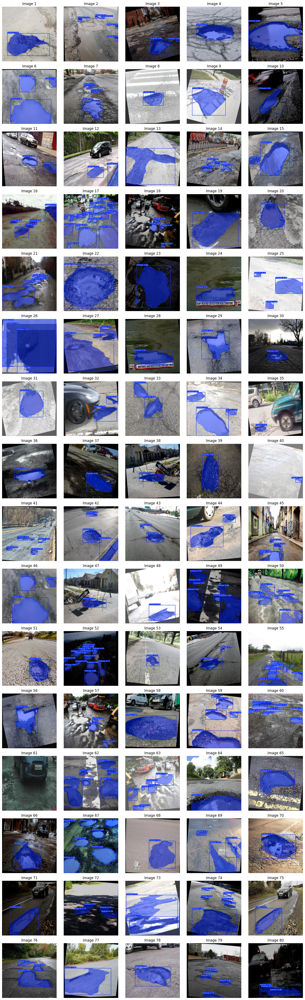

In [19]:
# Plot prediction on test images
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
# Specify the predict folder path
pred_path = '/content/runs/segment/predict'

# List all images in the predict folder
pred_image_files = [os.path.join(pred_path, img) for img in os.listdir(pred_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Number of images per row
images_per_row = 5

# Calculate the number of rows needed
n_rows = len(pred_image_files) // images_per_row + int(len(pred_image_files) % images_per_row != 0)

# Set figure size
fig, axs = plt.subplots(n_rows, images_per_row, figsize=(15, 3 * n_rows))

# Flatten axes if necessary (for easier iteration)
axs = axs.flatten()

# Loop through each image and display it
for i, img_path in enumerate(pred_image_files):
    img = mpimg.imread(img_path)      # Read the image
    axs[i].imshow(img)                # Show the image
    axs[i].axis('off')                # Turn off axis
    axs[i].set_title(f"Image {i+1}")  # Add title

# Hide any extra empty subplots (if the number of images is not a perfect multiple of images_per_row)
for j in range(i+1, len(axs)):
    axs[j].axis('off')  # Hide unused axes

# Display all images
plt.tight_layout()
plt.show()

**Inference on a Sample Video**

In [20]:
!gdown "https://drive.google.com/uc?id=1iMitK9VCUWmBcZiiEPHK1d2pydALof6s&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1iMitK9VCUWmBcZiiEPHK1d2pydALof6s&confirm=t
To: /content/demo.mp4
100% 4.39M/4.39M [00:00<00:00, 32.7MB/s]


In [21]:
results = model.predict(source = "/content/demo.mp4", save = True, conf = 0.25, iou = 0.3)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/324) /content/demo.mp4: 384x640 3 Potholes, 81.5ms
video 1/1 (frame 2/324) /content/demo.mp4: 384x640 3 Potholes, 13.9ms
video 1/1 (frame 3/324) /content/demo.mp4: 384x640 1 Pothole, 13.9ms
video 1/1 (frame 4/324) /content/demo.mp4: 384x640 1 Pothole, 13.9ms
video 1/1 (frame 5/324) /content/demo.mp4: 384x640 3 Potholes, 13.9ms
video 1/1 (frame 6/324) /content/demo.mp4: 384x640 (no detections), 13.9ms
video 1/1 (frame 7/324) /content/

In [22]:
!rm "/content/result_compressed.mp4"

rm: cannot remove '/content/result_compressed.mp4': No such file or directory


In [23]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/segment/predict/demo.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

In [24]:
!gdown "https://drive.google.com/uc?id=1_-JPW9TEWG_eyzWmT-jlfB2O5tzEiauW&confirm=t"

Downloading...
From: https://drive.google.com/uc?id=1_-JPW9TEWG_eyzWmT-jlfB2O5tzEiauW&confirm=t
To: /content/video2.mp4
100% 6.01M/6.01M [00:00<00:00, 33.8MB/s]


In [25]:
results = model.predict(source = "/content/video2.mp4", save = True, conf = 0.25, iou = 0.3)


WARNING ⚠️ 
inference results will accumulate in RAM unless `stream=True` is passed, causing potential out-of-memory
errors for large sources or long-running streams and videos. See https://docs.ultralytics.com/modes/predict/ for help.

Example:
    results = model(source=..., stream=True)  # generator of Results objects
    for r in results:
        boxes = r.boxes  # Boxes object for bbox outputs
        masks = r.masks  # Masks object for segment masks outputs
        probs = r.probs  # Class probabilities for classification outputs

video 1/1 (frame 1/375) /content/video2.mp4: 384x640 4 Potholes, 13.9ms
video 1/1 (frame 2/375) /content/video2.mp4: 384x640 4 Potholes, 14.3ms
video 1/1 (frame 3/375) /content/video2.mp4: 384x640 4 Potholes, 14.2ms
video 1/1 (frame 4/375) /content/video2.mp4: 384x640 3 Potholes, 14.0ms
video 1/1 (frame 5/375) /content/video2.mp4: 384x640 3 Potholes, 13.9ms
video 1/1 (frame 6/375) /content/video2.mp4: 384x640 3 Potholes, 14.2ms
video 1/1 (frame 7/375) 

In [26]:
!rm "/content/result_compressed.mp4"

In [27]:
from IPython.display import HTML
from base64 import b64encode
import os

# Input video path
save_path = '/content/runs/segment/predict/video2.avi'

# Compressed video path
compressed_path = "/content/result_compressed.mp4"

os.system(f"ffmpeg -i {save_path} -vcodec libx264 {compressed_path}")

# Show video
mp4 = open(compressed_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video width=400 controls>
      <source src="%s" type="video/mp4">
</video>
""" % data_url)